# FIT3081 Image Processing- Assignment 2 (S1, 2023)

### Name: Ng Kai Yi, 32156944
### Name: Wilbert Chong, 31110347

# Outline

### 1. Import Necessary Libraries

### 2. Preprocessing

*   Reading Image
*   Converting to grayscale
*   Resizing Image
*   Contrast Limited Adaptive Histogram Equalization 
*   Median Blur
*   Binarization(Adaptive Threshold)
*   Morphological Closing
*   Edge Detection (Canny)


### 3. Complete Flow of Car License Plate Detection 

#### 3.1 Complete Flow of Car License Plate Detection Using Customized Canny Edge Detection

* Report the accuracy 

#### 3.2 Complete Flow of Car License Plate Detection Using Built-in Canny Edge Detection

* Report the accuracy

# Import Necessary Libraries

In [1]:
# Importing necessary libraries
import numpy as np
from scipy.signal import convolve2d
import cv2
import os
import matplotlib.pyplot as plt

# Converting to grayscale image

In [2]:
def gray_scale(img):
    
    """
    This function converts a color image into grayscale using the manual method.
    """
    
    # Split the input color image into its blue, green, and red channels
    b, g, r = cv2.split(img)
    
    # Compute the grayscale image using the manual method
    gray = 0.299 * r + 0.587 * g + 0.114 * b
    
    # Convert the grayscale image to 8-bit integer data type
    gray = np.uint8(gray)
    
    return gray

# Resizing Image

In [3]:
def resize(img, width, height):
    """
    This function resizes an image to a given width and height.
    """
    img = cv2.resize(img, (width, height))
    return img

# Contrast Limited Adaptive Histogram Equalization

In [4]:
def apply_clahe(gray_img, clip_limit=2.0, tile_size=(8, 8)):
    """
    Apply Contrast Limited Adaptive Histogram Equalization to a grayscale image using OpenCV
    
    :param gray_img: Grayscale image as a numpy array
    :param clip_limit: Threshold for contrast limiting
    :param tile_size: Size of contextual regions for histogram equalization
    
    :return: CLAHE-adjusted grayscale image as a numpy array
    """
    # Create a CLAHE object
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_size)
    
    # Apply CLAHE to the grayscale image
    clahe_img = clahe.apply(gray_img)
    
    return clahe_img

# Median Blur

After implementing the medianBlur function manually, we found that its computational complexity was significantly higher compared to the built-in version (cv2.medianBlur), and the latter produced better accuracy results. Therefore, we decided to use the built-in medianBlur function instead.

In [5]:
def medianBlur(img, kernel_size):
    
    """
    Apply median filtering to an input grayscale image to reduce noise.

    Parameters:
    
    img: The input grayscale image as a NumPy array
    kernel_size: The size of the kernel to use for the median filter. This should be an odd integer.
    
    Returns:
    
    The median filtered image as a NumPy array with the same shape as the input image.
    """

    # Pad the image with zeros 
    padded_img = np.pad(img, kernel_size//2, mode='reflect')

    # Create an empty output image
    output = np.zeros_like(img)

    # Apply the median filter
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            # Extract the kernel_size x kernel_size neighborhood of pixels centered at (i, j)
            neighborhood = padded_img[i:i+kernel_size, j:j+kernel_size]
            # Compute the median of the neighborhood and assign it to the output image
            output[i, j] = np.median(neighborhood)

    return output

# Binarization (Adaptive Thresholding)

After implementing the adaptive threshold function manually, we found that its computational complexity was significantly higher compared to the built-in version (cv2.adaptiveThreshold), and the latter produced better accuracy results. Therefore, we decided to use the built-in medianBlur function instead.

In [6]:
def adaptive_threshold(img, max_value=255, method=cv2.ADAPTIVE_THRESH_GAUSSIAN_C, threshold_type=cv2.THRESH_BINARY, 
                       block_size=41, constant=2,):
    """
    Apply adaptive thresholding to an input grayscale image to produce a binary image.

    Parameters:

    img: grayscale image
    max_value: The maximum value of the output image. By default, it is set to 255.
    method: The adaptive thresholding method to use. By default, it is set to cv2.ADAPTIVE_THRESH_GAUSSIAN_C.
    threshold_type: The type of thresholding to apply. By default, it is set to cv2.THRESH_BINARY.
    block_size: The size of the neighborhood around each pixel to use. It should be an odd integer. By default, it is set to 41.
    constant: A constant value to subtract from the mean of the neighborhood or to multiply by the standard deviation 
              of the neighborhood. By default, it is set to 2.

    Returns:

    The binary thresholded image 
    """
    # Create an output image 
    output = np.zeros_like(img)

    # Apply adaptive thresholding 
    for y in range(img.shape[0]):
        for x in range(img.shape[1]):
            # Extract the local neighborhood around the current pixel
            x_min = max(0, x - block_size // 2)
            x_max = min(img.shape[1] - 1, x + block_size // 2)
            y_min = max(0, y - block_size // 2)
            y_max = min(img.shape[0] - 1, y + block_size // 2)
            neighborhood = img[y_min:y_max+1, x_min:x_max+1]

            # Compute the threshold value for the current pixel based on the neighborhood
            if method == cv2.ADAPTIVE_THRESH_GAUSSIAN_C:
                threshold = np.mean(neighborhood) - constant * np.std(neighborhood) / max_value
            else:
                threshold = np.mean(neighborhood) - constant
            
            threshold = np.clip(threshold, 0, 255)

            # Apply the binary threshold to the current pixel
            if img[y, x] > threshold:
                if threshold_type == cv2.THRESH_BINARY:
                    output[y, x] = max_value
                else:
                    output[y, x] = 0
            else:
                if threshold_type == cv2.THRESH_BINARY:
                    output[y, x] = 0
                else:
                    output[y, x] = max_value

    return output

# Morphological Closing

In [7]:
def morphology_close(gray, kernel_size=(3, 3)):
    """
    Applies morphological closing to a grayscale image using a rectangular structuring element.
    """
        
    # Create the structuring element
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, kernel_size)

    # Perform morphological closing
    closed = cv2.morphologyEx(gray, cv2.MORPH_CLOSE, kernel)

    return closed

# Edge Detection (Canny)

In [8]:
def non_maximum_supression(M, angle):
    """
    Performs non-maximum suppression
    """
    E = np.zeros(M.shape)
    
    # created a padding magnitude np to compare with the original magnitude
    pad_M = np.pad(M, ((1, 1), (1, 1)), mode='constant')
    for i in range(E.shape[0]):
        for j in range(E.shape[1]):
            theta = angle[i,j]
            
            # S[i,j] = 0, the horizontal pixel pair is examined
            if 337.5 <= theta or theta <= 22.5 or 157.5 <= theta <= 202.5:
                if M[i, j] > pad_M[i + 1, j] and M[i, j] > pad_M[i + 1, j + 2]:
                    E[i, j] = M[i, j]
            
            # S[i,j] = 1, the diagonal(45) pixel pair is examined
            elif  22.5 <= theta <= 67.5 or 202.5 <= theta <= 247.5:
                if M[i, j] > pad_M[i, j+2] and M[i, j] > pad_M[i+2, j]:
                    E[i, j] = M[i, j]
            
            # S[i,j] = 2, the vertical pixel pair is examined
            elif  67.5 <= theta <= 112.5 or 247.5 <= theta <= 292.5:
                if M[i, j] > pad_M[i, j + 1] and M[i, j] > pad_M[i+2, j + 1]:
                    E[i, j] = M[i, j]
            
            # S[i,j] = 3, the diagonal(135) pixel pair is examined
            elif 112.5 <= theta <= 157.5 or 292.5 <= theta <= 337.5:
                if M[i, j] > pad_M[i, j + 1] and M[i, j] > pad_M[i+1, j + 1]:
                    E[i, j] = M[i, j]
                    
    return E

In [9]:
def doub_thres(E, low_thresh, high_thresh):
    """
    Apply double thresholding to the output of the non-maximum suppression function.
    """
    # Create an array for strong edges and set any pixel in E greater than the high threshold to 1
    strong_edges = np.zeros(E.shape)
    strong_edges[E > high_thresh] = 1
    
    # Create an array for weak edges and set any pixel in E between the low and high threshold values to 1
    weak_edges = np.zeros(E.shape)
    weak_edges[(E >= low_thresh) & (E <= high_thresh)] = 1
    
    return weak_edges, strong_edges

In [10]:
def hysteresis(E, low, high):
    
    # Apply double thresholding to get the weak_edges and strong edges
    weak_edges, strong_edges = doub_thres(E, low, high)
    
    # Do zero padding 
    padded_strong_edges = np.pad(strong_edges, ((1, 1), (1, 1)), mode='constant', constant_values=0)
    
    for i in range(1, padded_strong_edges.shape[0]-1):
        for j in range(1, padded_strong_edges.shape[1]-1):
            if weak_edges[i-1, j-1] == 1:
                # Inspecting the neighboring edges, and if any one of them is an edge, it is set to become an edge.
                if padded_strong_edges[i-1:i+2, j-1:j+2].max() == 1:
                    strong_edges[i-1, j-1] = 1

    strong_edges[strong_edges == 1] = 255
    return strong_edges

In [11]:
def canny_alg(img, low_thres, high_thres):
    """
    Apply the Canny edge detection algorithm to an input image.The process includes several steps, such as performing 
    a Gaussian blur, calculating gradients, performing non-maximum suppression, double thresholding, and applying hysteresis 
    to obtain the resulting edge image.
    """
    
    # Perform Gaussian blur
    img = cv2.GaussianBlur(img, (3, 3), 0)
    
    # Sobel Operator
    Kx = np.matrix('-1, 0, 1; -2, 0, 2;, -1, 0, 1')
    Ky = np.matrix('-1, -2, -1; 0, 0, 0;, 1, 2, 1')
    
    # Calculate gradients in x and y directions
    Gx = convolve2d(img, Kx, "same")
    Gy = convolve2d(img, Ky, "same")
    
    # Calculate the magnitude and angle of gradients
    mag = np.sqrt(Gx**2 + Gy**2)
    angle = np.arctan2(Gy, Gx) * 180 / np.pi
    angle[angle < 0] += 180
    
    # Perform non-maximum suppression to thin out edges
    E = non_maximum_supression(mag,angle)
    
    # Apply double thresholding to identify weak and strong edges and apply hysteresis to convert weak edges to strong edges 
    # if connected to strong edges. *** Double thresholding is performed in the hysteresis function***
    output = hysteresis(E, low_thres, high_thres).astype(np.uint8)

    return output

# Car License Plate Detection Using Customized Canny Edge Detection

After experimenting with customized canny edge detection for car plate detection, we found that it resulted in 0% accuracy and a longer runtime. Therefore, we decided to switch to the built-in canny edge detection, which employs more advanced techniques and provides better accuracy.

## Dataset 1

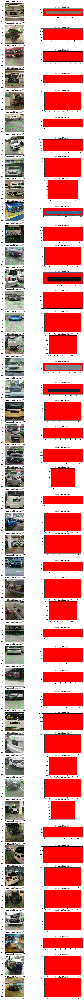

In [12]:
# Set the directory
dir = r"C:\Users\ngkai\Monash\Y3S2\FIT3081 Image Processing\Assignment\Assignment 1\Car Plate\Set 1 - 45"

fig, axs = plt.subplots(len(os.listdir(dir)), 2, figsize=(12, 3*len(os.listdir(dir))))

# Loop through all the images 
for i, pic in enumerate(os.listdir(dir)):
    pic_dir = os.path.join(dir,pic)
    
    """
    Preprocessing of the image
    
    *   Reading Image
    *   Converting to grayscale
    *   Resizing Image
    *   Contrast Limited Adaptive Histogram Equalization 
    *   Median Blur
    *   Binarization(Adaptive Threshold)
    *   Morphological Closing
    *   Edge Detection (Canny)
    """
    
    img = cv2.imread(pic_dir)
    img = cv2.resize(img, (1024, 1024))
    
    # Convert to grayscale and preprocess the image
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Apply Contrast Limited Adaptive Histogram Equalization (CLAHE) to enhance contrast.
    gray = apply_clahe(gray)
    
    # Apply a median filter with a kernel size of 5x5 to remove salt-and-pepper noise.
    gray = cv2.medianBlur(gray, 5)
    
    # Apply adaptive thresholding using a Gaussian window with a block size of 41 and a constant offset of 2 to 
    # binarize the image.
    gray = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 41, 2)
    
    # Apply morphological closing to fill in any small gaps in the thresholded image.
    gray = morphology_close(gray)
    
    # Apply Canny edge detection
    edges = canny_alg(gray, 100, 200)
    
    # Apply Canny edge detection
    # edges = cv2.Canny(gray, 100, 200)
    
    """
    Car Plate Detection
    
    * Detect contours of objects in the image using the cv2.findContours() function.

    * For each contour, calculate its area using the cv2.contourArea() function.

    * Calculate the perimeter of the contour using the cv2.arcLength() function.

    * Approximate the contour shape using the cv2.approxPolyDP() function. 

    * Check if the approximated contour has 4 vertices. If yes, it means that the contour is a quadrilateral.

    * If the contour is a quadrilateral, calculate its bounding box using the cv2.boundingRect() function.
    This function returns the coordinates of a rectangle that completely covers the contour.

    * Calculate the aspect ratio of the bounding box by dividing its width by its height.
    
    * If the bounding box has an aspect ratio within the range of min_aspect_ratio to max_aspect_ratio, and it also has the 
    largest area among all the bounding boxes, we consider it as a car plate.
    
    """
        
    # Detect contours in the thresholded image
    contours, hierarchy = cv2.findContours(edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    best_contour = None
    best_area = 0
    min_aspect_ratio = 1.0
    max_aspect_ratio = 6.0
    all_rect = img.copy()
    
    # Loop through all the contours
    for contour in contours:
        # Calculate the area of the contour
        area = cv2.contourArea(contour)
        
        # Calculate the perimeter of the contour using the cv2.arcLength() function.
        perimeter = cv2.arcLength(contour, True)
        
        # Approximate the contour shape using the cv2.approxPolyDP() function. 
        approx = cv2.approxPolyDP(contour, 0.02 * perimeter, True)
        
        # Check if the contour has 4 vertices, which is a quadrilateral
        if len(approx) == 4:
            x, y, w, h = cv2.boundingRect(contour)
            
            # Calculate the aspect ratio
            aspect_ratio = float(w) / h
            if min_aspect_ratio < aspect_ratio < max_aspect_ratio:
                # Draw bounding rectangle around all possible car plates 
                cv2.rectangle(all_rect, (x, y), (x+w, y+h), (0, 255, 0), 2)
                if area > best_area:
                    best_area = area
                    best_contour = contour

    # Draw bounding rectangle around the best contour
    if best_contour is not None:
        x, y, w, h = cv2.boundingRect(best_contour)
        cv2.rectangle(img, (x, y), (x+w, y+h), (0, 0, 255), 2)

    # Plot the image with all possible rectangles drawn and image with only one car plate detected
    axs[i, 0].imshow(cv2.cvtColor(all_rect, cv2.COLOR_BGR2RGB))
    axs[i, 0].set_title('All Possible Car Plates')
    axs[i, 1].imshow(cv2.cvtColor(img[y:y+h, x:x+w], cv2.COLOR_BGR2RGB))
    axs[i, 1].set_title('Detected Car Plate')

plt.show()

## Dataset 2

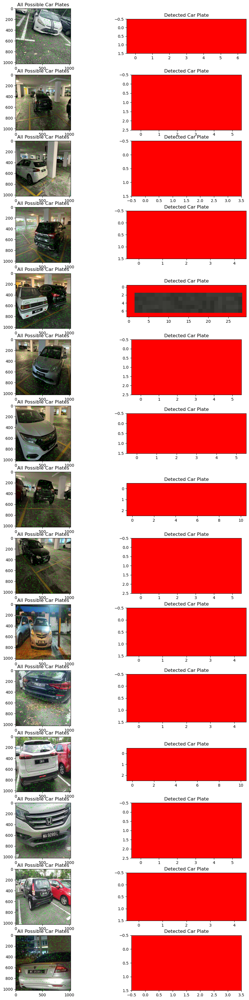

In [13]:
# Set the directory
dir = r"C:\Users\ngkai\Monash\Y3S2\FIT3081 Image Processing\Assignment\Assignment 1\Car Plate\Set 2 - 15"

fig, axs = plt.subplots(len(os.listdir(dir)), 2, figsize=(12, 3*len(os.listdir(dir))))

# Loop through all the images 
for i, pic in enumerate(os.listdir(dir)):
    pic_dir = os.path.join(dir,pic)
    
    """
    Preprocessing of the image
    
    *   Reading Image
    *   Converting to grayscale
    *   Resizing Image
    *   Contrast Limited Adaptive Histogram Equalization 
    *   Median Blur
    *   Binarization(Adaptive Threshold)
    *   Morphological Closing
    *   Edge Detection (Canny)
    """
    
    img = cv2.imread(pic_dir)
    img = cv2.resize(img, (1024, 1024))
    
    # Convert to grayscale and preprocess the image
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Apply Contrast Limited Adaptive Histogram Equalization (CLAHE) to enhance contrast.
    gray = apply_clahe(gray)
    
    # Apply a median filter with a kernel size of 5x5 to remove salt-and-pepper noise.
    gray = cv2.medianBlur(gray, 5)
    
    # Apply adaptive thresholding using a Gaussian window with a block size of 41 and a constant offset of 2 to 
    # binarize the image.
    gray = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 41, 2)
    
    # Apply morphological closing to fill in any small gaps in the thresholded image.
    gray = morphology_close(gray)
    
    # Apply Canny edge detection
    edges = canny_alg(gray, 100, 200)
    
    """
    Car Plate Detection
    
    * Detect contours of objects in the image using the cv2.findContours() function.

    * For each contour, calculate its area using the cv2.contourArea() function.

    * Calculate the perimeter of the contour using the cv2.arcLength() function.

    * Approximate the contour shape using the cv2.approxPolyDP() function. 

    * Check if the approximated contour has 4 vertices. If yes, it means that the contour is a quadrilateral.

    * If the contour is a quadrilateral, calculate its bounding box using the cv2.boundingRect() function.
    This function returns the coordinates of a rectangle that completely covers the contour.

    * Calculate the aspect ratio of the bounding box by dividing its width by its height.
    
    * If the bounding box has an aspect ratio within the range of min_aspect_ratio to max_aspect_ratio, and it also has the 
    largest area among all the bounding boxes, we consider it as a car plate.
    
    """
        
    # Detect contours in the thresholded image
    contours, hierarchy = cv2.findContours(edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    best_contour = None
    best_area = 0
    min_aspect_ratio = 1.0
    max_aspect_ratio = 6.0
    all_rect = img.copy()
    
    # Loop through all the contours
    for contour in contours:
        # Calculate the area of the contour
        area = cv2.contourArea(contour)
        
        # Calculate the perimeter of the contour using the cv2.arcLength() function.
        perimeter = cv2.arcLength(contour, True)
        
        # Approximate the contour shape using the cv2.approxPolyDP() function. 
        approx = cv2.approxPolyDP(contour, 0.02 * perimeter, True)
        
        # Check if the contour has 4 vertices, which is a quadrilateral
        if len(approx) == 4:
            x, y, w, h = cv2.boundingRect(contour)
            
            # Calculate the aspect ratio
            aspect_ratio = float(w) / h
            if min_aspect_ratio < aspect_ratio < max_aspect_ratio:
                # Draw bounding rectangle around all possible car plates 
                cv2.rectangle(all_rect, (x, y), (x+w, y+h), (0, 255, 0), 2)
                if area > best_area:
                    best_area = area
                    best_contour = contour

    # Draw bounding rectangle around the best contour
    if best_contour is not None:
        x, y, w, h = cv2.boundingRect(best_contour)
        cv2.rectangle(img, (x, y), (x+w, y+h), (0, 0, 255), 2)

    # Plot the image with all possible rectangles drawn and image with only one car plate detected
    axs[i, 0].imshow(cv2.cvtColor(all_rect, cv2.COLOR_BGR2RGB))
    axs[i, 0].set_title('All Possible Car Plates')
    axs[i, 1].imshow(cv2.cvtColor(img[y:y+h, x:x+w], cv2.COLOR_BGR2RGB))
    axs[i, 1].set_title('Detected Car Plate')

plt.show()

## Dataset 3

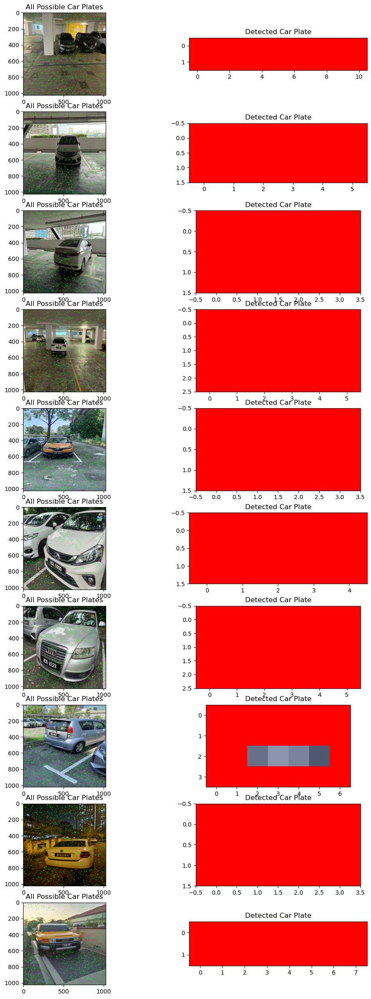

In [14]:
# Set the directory
dir = r"C:\Users\ngkai\Monash\Y3S2\FIT3081 Image Processing\Assignment\Assignment 1\Car Plate\Set 3 - 10"

fig, axs = plt.subplots(len(os.listdir(dir)), 2, figsize=(12, 3*len(os.listdir(dir))))

# Loop through all the images 
for i, pic in enumerate(os.listdir(dir)):
    pic_dir = os.path.join(dir,pic)
    
    """
    Preprocessing of the image
    
    *   Reading Image
    *   Converting to grayscale
    *   Resizing Image
    *   Contrast Limited Adaptive Histogram Equalization 
    *   Median Blur
    *   Binarization(Adaptive Threshold)
    *   Morphological Closing
    *   Edge Detection (Canny)
    """
    
    img = cv2.imread(pic_dir)
    img = cv2.resize(img, (1024, 1024))
    
    # Convert to grayscale and preprocess the image
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Apply Contrast Limited Adaptive Histogram Equalization (CLAHE) to enhance contrast.
    gray = apply_clahe(gray)
    
    # Apply a median filter with a kernel size of 5x5 to remove salt-and-pepper noise.
    gray = cv2.medianBlur(gray, 5)
    
    # Apply adaptive thresholding using a Gaussian window with a block size of 41 and a constant offset of 2 to 
    # binarize the image.
    gray = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 41, 2)
    
    # Apply morphological closing to fill in any small gaps in the thresholded image.
    gray = morphology_close(gray)
    
    # Apply Canny edge detection
    edges = canny_alg(gray, 100, 200)
    
    """
    Car Plate Detection
    
    * Detect contours of objects in the image using the cv2.findContours() function.

    * For each contour, calculate its area using the cv2.contourArea() function.

    * Calculate the perimeter of the contour using the cv2.arcLength() function.

    * Approximate the contour shape using the cv2.approxPolyDP() function. 

    * Check if the approximated contour has 4 vertices. If yes, it means that the contour is a quadrilateral.

    * If the contour is a quadrilateral, calculate its bounding box using the cv2.boundingRect() function.
    This function returns the coordinates of a rectangle that completely covers the contour.

    * Calculate the aspect ratio of the bounding box by dividing its width by its height.
    
    * If the bounding box has an aspect ratio within the range of min_aspect_ratio to max_aspect_ratio, and it also has the 
    largest area among all the bounding boxes, we consider it as a car plate.
    
    """
        
    # Detect contours in the thresholded image
    contours, hierarchy = cv2.findContours(edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    best_contour = None
    best_area = 0
    min_aspect_ratio = 1.0
    max_aspect_ratio = 6.0
    all_rect = img.copy()
    
    # Loop through all the contours
    for contour in contours:
        # Calculate the area of the contour
        area = cv2.contourArea(contour)
        
        # Calculate the perimeter of the contour using the cv2.arcLength() function.
        perimeter = cv2.arcLength(contour, True)
        
        # Approximate the contour shape using the cv2.approxPolyDP() function. 
        approx = cv2.approxPolyDP(contour, 0.02 * perimeter, True)
        
        # Check if the contour has 4 vertices, which is a quadrilateral
        if len(approx) == 4:
            x, y, w, h = cv2.boundingRect(contour)
            
            # Calculate the aspect ratio
            aspect_ratio = float(w) / h
            if min_aspect_ratio < aspect_ratio < max_aspect_ratio:
                # Draw bounding rectangle around all possible car plates 
                cv2.rectangle(all_rect, (x, y), (x+w, y+h), (0, 255, 0), 2)
                if area > best_area:
                    best_area = area
                    best_contour = contour

    # Draw bounding rectangle around the best contour
    if best_contour is not None:
        x, y, w, h = cv2.boundingRect(best_contour)
        cv2.rectangle(img, (x, y), (x+w, y+h), (0, 0, 255), 2)

    # Plot the image with all possible rectangles drawn and image with only one car plate detected
    axs[i, 0].imshow(cv2.cvtColor(all_rect, cv2.COLOR_BGR2RGB))
    axs[i, 0].set_title('All Possible Car Plates')
    axs[i, 1].imshow(cv2.cvtColor(img[y:y+h, x:x+w], cv2.COLOR_BGR2RGB))
    axs[i, 1].set_title('Detected Car Plate')

plt.show()

### Accuracy table

| Dataset | Number of Image | Accuracy |
| --- | --- | --- |
| 1 | 45 | 0/45 |
| 2 | 15 | 0/15 |
| 3 | 10 | 0/10 |

# Car License Plate Detection Using Built-in Canny Edge Detection

## Dataset 1

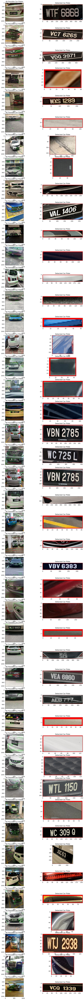

In [15]:
# Set the directory
dir = r"C:\Users\ngkai\Monash\Y3S2\FIT3081 Image Processing\Assignment\Assignment 1\Car Plate\Set 1 - 45"

fig, axs = plt.subplots(len(os.listdir(dir)), 2, figsize=(12, 3*len(os.listdir(dir))))

# Loop through all the images 
for i, pic in enumerate(os.listdir(dir)):
    pic_dir = os.path.join(dir,pic)
    
    """
    Preprocessing of the image
    
    *   Reading Image
    *   Converting to grayscale
    *   Resizing Image
    *   Contrast Limited Adaptive Histogram Equalization 
    *   Median Blur
    *   Binarization(Adaptive Threshold)
    *   Morphological Closing
    *   Edge Detection (Canny)
    """
    
    img = cv2.imread(pic_dir)
    img = cv2.resize(img, (1024, 1024))
    
    # Convert to grayscale and preprocess the image
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Apply Contrast Limited Adaptive Histogram Equalization (CLAHE) to enhance contrast.
    gray = apply_clahe(gray)
    
    # Apply a median filter with a kernel size of 5x5 to remove salt-and-pepper noise.
    gray = cv2.medianBlur(gray, 5)
    
    # Apply adaptive thresholding using a Gaussian window with a block size of 41 and a constant offset of 2 to 
    # binarize the image.
    gray = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 41, 2)
    
    # Apply morphological closing to fill in any small gaps in the thresholded image.
    gray = morphology_close(gray)
    
    # Apply Canny edge detection
    edges = cv2.Canny(gray, 100, 200)
    
    """
    Car Plate Detection
    
    * Detect contours of objects in the image using the cv2.findContours() function.

    * For each contour, calculate its area using the cv2.contourArea() function.

    * Calculate the perimeter of the contour using the cv2.arcLength() function.

    * Approximate the contour shape using the cv2.approxPolyDP() function. 

    * Check if the approximated contour has 4 vertices. If yes, it means that the contour is a quadrilateral.

    * If the contour is a quadrilateral, calculate its bounding box using the cv2.boundingRect() function.
    This function returns the coordinates of a rectangle that completely covers the contour.

    * Calculate the aspect ratio of the bounding box by dividing its width by its height.
    
    * If the bounding box has an aspect ratio within the range of min_aspect_ratio to max_aspect_ratio, and it also has the 
    largest area among all the bounding boxes, we consider it as a car plate.
    
    """
        
    # Detect contours in the thresholded image
    contours, hierarchy = cv2.findContours(edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    best_contour = None
    best_area = 0
    min_aspect_ratio = 1.0
    max_aspect_ratio = 6.0
    all_rect = img.copy()
    
    # Loop through all the contours
    for contour in contours:
        # Calculate the area of the contour
        area = cv2.contourArea(contour)
        
        # Calculate the perimeter of the contour using the cv2.arcLength() function.
        perimeter = cv2.arcLength(contour, True)
        
        # Approximate the contour shape using the cv2.approxPolyDP() function. 
        approx = cv2.approxPolyDP(contour, 0.02 * perimeter, True)
        
        # Check if the contour has 4 vertices, which is a quadrilateral
        if len(approx) == 4:
            x, y, w, h = cv2.boundingRect(contour)
            
            # Calculate the aspect ratio
            aspect_ratio = float(w) / h
            if min_aspect_ratio < aspect_ratio < max_aspect_ratio:
                # Draw bounding rectangle around all possible car plates 
                cv2.rectangle(all_rect, (x, y), (x+w, y+h), (0, 255, 0), 2)
                if area > best_area:
                    best_area = area
                    best_contour = contour

    # Draw bounding rectangle around the best contour
    if best_contour is not None:
        x, y, w, h = cv2.boundingRect(best_contour)
        cv2.rectangle(img, (x, y), (x+w, y+h), (0, 0, 255), 2)

    # Plot the image with all possible rectangles drawn and image with only one car plate detected
    axs[i, 0].imshow(cv2.cvtColor(all_rect, cv2.COLOR_BGR2RGB))
    axs[i, 0].set_title('All Possible Car Plates')
    axs[i, 1].imshow(cv2.cvtColor(img[y:y+h, x:x+w], cv2.COLOR_BGR2RGB))
    axs[i, 1].set_title('Detected Car Plate')

plt.show()

## Dataset 2

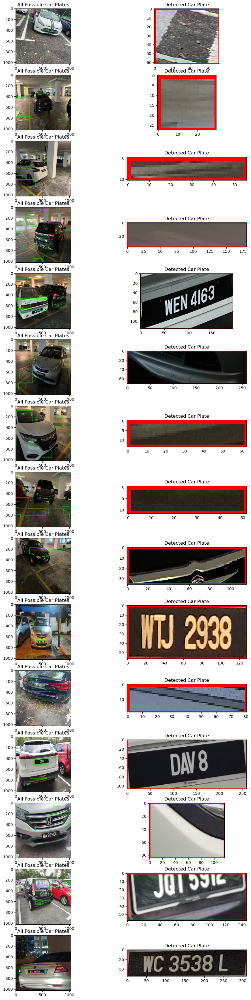

In [16]:
# Set the directory
dir = r"C:\Users\ngkai\Monash\Y3S2\FIT3081 Image Processing\Assignment\Assignment 1\Car Plate\Set 2 - 15"

fig, axs = plt.subplots(len(os.listdir(dir)), 2, figsize=(12, 3*len(os.listdir(dir))))

# Loop through all the images 
for i, pic in enumerate(os.listdir(dir)):
    pic_dir = os.path.join(dir,pic)
    
    """
    Preprocessing of the image
    
    *   Reading Image
    *   Converting to grayscale
    *   Resizing Image
    *   Contrast Limited Adaptive Histogram Equalization 
    *   Median Blur
    *   Binarization(Adaptive Threshold)
    *   Morphological Closing
    *   Edge Detection (Canny)
    """
    
    img = cv2.imread(pic_dir)
    img = cv2.resize(img, (1024, 1024))
    
    # Convert to grayscale and preprocess the image
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Apply Contrast Limited Adaptive Histogram Equalization (CLAHE) to enhance contrast.
    gray = apply_clahe(gray)
    
    # Apply a median filter with a kernel size of 5x5 to remove salt-and-pepper noise.
    gray = cv2.medianBlur(gray, 5)
    
    # Apply adaptive thresholding using a Gaussian window with a block size of 41 and a constant offset of 2 to 
    # binarize the image.
    gray = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 41, 2)
    
    # Apply morphological closing to fill in any small gaps in the thresholded image.
    gray = morphology_close(gray)
    
    # Apply Canny edge detection
    edges = cv2.Canny(gray, 100, 200)
    
    """
    Car Plate Detection
    
    * Detect contours of objects in the image using the cv2.findContours() function.

    * For each contour, calculate its area using the cv2.contourArea() function.

    * Calculate the perimeter of the contour using the cv2.arcLength() function.

    * Approximate the contour shape using the cv2.approxPolyDP() function. 

    * Check if the approximated contour has 4 vertices. If yes, it means that the contour is a quadrilateral.

    * If the contour is a quadrilateral, calculate its bounding box using the cv2.boundingRect() function.
    This function returns the coordinates of a rectangle that completely covers the contour.

    * Calculate the aspect ratio of the bounding box by dividing its width by its height.
    
    * If the bounding box has an aspect ratio within the range of min_aspect_ratio to max_aspect_ratio, and it also has the 
    largest area among all the bounding boxes, we consider it as a car plate.
    
    """
        
    # Detect contours in the thresholded image
    contours, hierarchy = cv2.findContours(edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    best_contour = None
    best_area = 0
    min_aspect_ratio = 1.0
    max_aspect_ratio = 6.0
    all_rect = img.copy()
    
    # Loop through all the contours
    for contour in contours:
        # Calculate the area of the contour
        area = cv2.contourArea(contour)
        
        # Calculate the perimeter of the contour using the cv2.arcLength() function.
        perimeter = cv2.arcLength(contour, True)
        
        # Approximate the contour shape using the cv2.approxPolyDP() function. 
        approx = cv2.approxPolyDP(contour, 0.02 * perimeter, True)
        
        # Check if the contour has 4 vertices, which is a quadrilateral
        if len(approx) == 4:
            x, y, w, h = cv2.boundingRect(contour)
            
            # Calculate the aspect ratio
            aspect_ratio = float(w) / h
            if min_aspect_ratio < aspect_ratio < max_aspect_ratio:
                # Draw bounding rectangle around all possible car plates 
                cv2.rectangle(all_rect, (x, y), (x+w, y+h), (0, 255, 0), 2)
                if area > best_area:
                    best_area = area
                    best_contour = contour

    # Draw bounding rectangle around the best contour
    if best_contour is not None:
        x, y, w, h = cv2.boundingRect(best_contour)
        cv2.rectangle(img, (x, y), (x+w, y+h), (0, 0, 255), 2)

    # Plot the image with all possible rectangles drawn and image with only one car plate detected
    axs[i, 0].imshow(cv2.cvtColor(all_rect, cv2.COLOR_BGR2RGB))
    axs[i, 0].set_title('All Possible Car Plates')
    axs[i, 1].imshow(cv2.cvtColor(img[y:y+h, x:x+w], cv2.COLOR_BGR2RGB))
    axs[i, 1].set_title('Detected Car Plate')

plt.show()

## Dataset 3

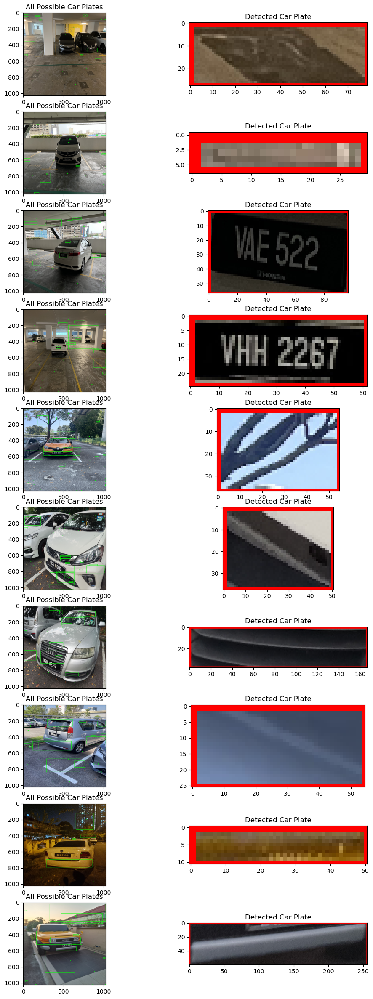

In [17]:
# Set the directory
dir = r"C:\Users\ngkai\Monash\Y3S2\FIT3081 Image Processing\Assignment\Assignment 1\Car Plate\Set 3 - 10"

fig, axs = plt.subplots(len(os.listdir(dir)), 2, figsize=(12, 3*len(os.listdir(dir))))

# Loop through all the images 
for i, pic in enumerate(os.listdir(dir)):
    pic_dir = os.path.join(dir,pic)
    
    """
    Preprocessing of the image
    
    *   Reading Image
    *   Converting to grayscale
    *   Resizing Image
    *   Contrast Limited Adaptive Histogram Equalization 
    *   Median Blur
    *   Binarization(Adaptive Threshold)
    *   Morphological Closing
    *   Edge Detection (Canny)
    """
    
    img = cv2.imread(pic_dir)
    img = cv2.resize(img, (1024, 1024))
    
    # Convert to grayscale and preprocess the image
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Apply Contrast Limited Adaptive Histogram Equalization (CLAHE) to enhance contrast.
    gray = apply_clahe(gray)
    
    # Apply a median filter with a kernel size of 5x5 to remove salt-and-pepper noise.
    gray = cv2.medianBlur(gray, 5)
    
    # Apply adaptive thresholding using a Gaussian window with a block size of 41 and a constant offset of 2 to 
    # binarize the image.
    gray = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 41, 2)
    
    # Apply morphological closing to fill in any small gaps in the thresholded image.
    gray = morphology_close(gray)
    
    # Apply Canny edge detection
    edges = cv2.Canny(gray, 100, 200)
    
    """
    Car Plate Detection
    
    * Detect contours of objects in the image using the cv2.findContours() function.

    * For each contour, calculate its area using the cv2.contourArea() function.

    * Calculate the perimeter of the contour using the cv2.arcLength() function.

    * Approximate the contour shape using the cv2.approxPolyDP() function. 

    * Check if the approximated contour has 4 vertices. If yes, it means that the contour is a quadrilateral.

    * If the contour is a quadrilateral, calculate its bounding box using the cv2.boundingRect() function.
    This function returns the coordinates of a rectangle that completely covers the contour.

    * Calculate the aspect ratio of the bounding box by dividing its width by its height.
    
    * If the bounding box has an aspect ratio within the range of min_aspect_ratio to max_aspect_ratio, and it also has the 
    largest area among all the bounding boxes, we consider it as a car plate.
    
    """
        
    # Detect contours in the thresholded image
    contours, hierarchy = cv2.findContours(edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    best_contour = None
    best_area = 0
    min_aspect_ratio = 1.0
    max_aspect_ratio = 6.0
    all_rect = img.copy()
    
    # Loop through all the contours
    for contour in contours:
        # Calculate the area of the contour
        area = cv2.contourArea(contour)
        
        # Calculate the perimeter of the contour using the cv2.arcLength() function.
        perimeter = cv2.arcLength(contour, True)
        
        # Approximate the contour shape using the cv2.approxPolyDP() function. 
        approx = cv2.approxPolyDP(contour, 0.02 * perimeter, True)
        
        # Check if the contour has 4 vertices, which is a quadrilateral
        if len(approx) == 4:
            x, y, w, h = cv2.boundingRect(contour)
            
            # Calculate the aspect ratio
            aspect_ratio = float(w) / h
            if min_aspect_ratio < aspect_ratio < max_aspect_ratio:
                # Draw bounding rectangle around all possible car plates 
                cv2.rectangle(all_rect, (x, y), (x+w, y+h), (0, 255, 0), 2)
                if area > best_area:
                    best_area = area
                    best_contour = contour

    # Draw bounding rectangle around the best contour
    if best_contour is not None:
        x, y, w, h = cv2.boundingRect(best_contour)
        cv2.rectangle(img, (x, y), (x+w, y+h), (0, 0, 255), 2)

    # Plot the image with all possible rectangles drawn and image with only one car plate detected
    axs[i, 0].imshow(cv2.cvtColor(all_rect, cv2.COLOR_BGR2RGB))
    axs[i, 0].set_title('All Possible Car Plates')
    axs[i, 1].imshow(cv2.cvtColor(img[y:y+h, x:x+w], cv2.COLOR_BGR2RGB))
    axs[i, 1].set_title('Detected Car Plate')

plt.show()

### Accuracy table

| Dataset | Number of Image | Accuracy |
| --- | --- | --- |
| 1 | 45 | 17/45 |
| 2 | 15 | 4/15 |
| 3 | 10 | 2/10 |